<center>
<font size='7' style="color:#0D47A1">  <b>DEEP DREAM</b></font>
</center>

<br>

<br>    
<br>    
<br>    
<font size='6' style="color:#00A6D6">  <b>Introduction</b></font>

In the past we wanted to see what does machine learning algorithms actually learn. We picked a fractal, and we trained a machine learning algorithm with samples of the fractal pixels, after that we asked the algorithm to predict the whole image.

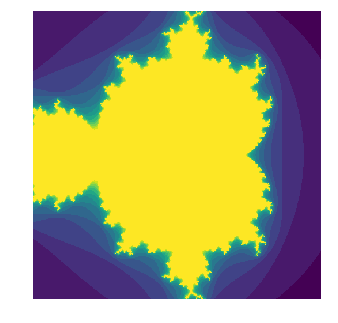

In [199]:
from IPython.display import Image
Image('Mandel.png')

Here we can see the prediction given by the  KNN 

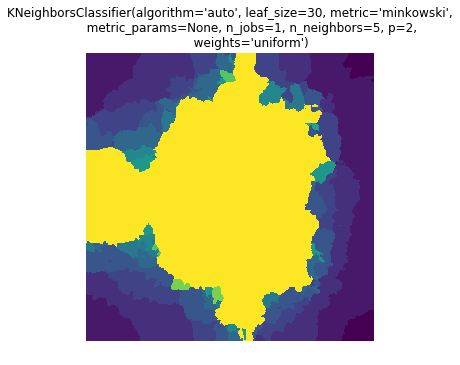

In [174]:
from IPython.display import Image
Image('KN_Mandel.png')

Today we are going to work with a neural network, we will fix a layer and put together all the concepts that the layer is learning into the input image.

Alebrijes (like the ones in the movie coco) are created by putting together the mixture of 7 animals that appear in your dreams.

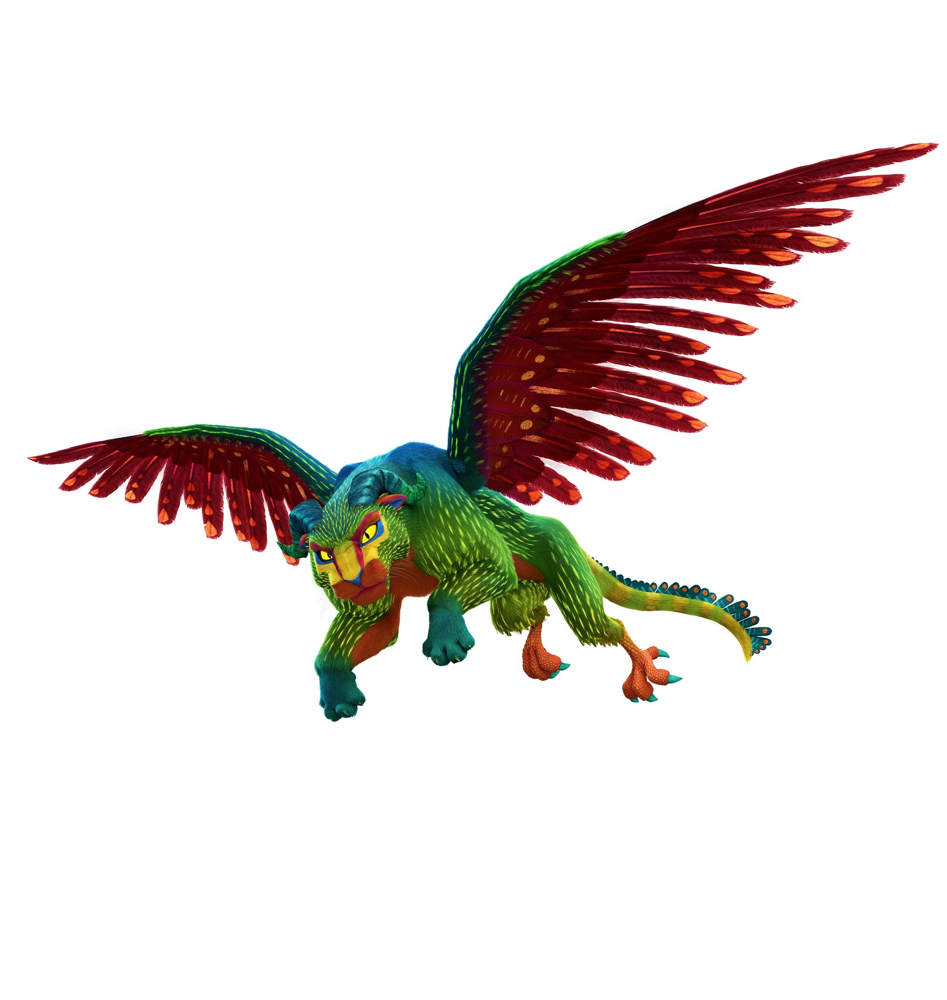

In [178]:
Image('alebrije.png')

"A deep dream is a program that uses a convolutional neural network to find and enhance patterns in images via algorithmic pareidolia, thus creating dream like hallucinogenic appearance in the delierately over processed images."

Given an image and a layer of a convnet, the main two questions we will work on are:


    How to modify the image to obtain a dream?
    How does the dream depend on the layer?
    

<br>    
<br>    
<br>    
<font size='6' style="color:#00A6D6">  <b>How to modify the image to obtain a dream?</b></font>


We start with a trained convolutional neural network.


#### Inception 5h

We work with inception 5h. It is not known the real name of this convenet but people call it by the name of the download file.

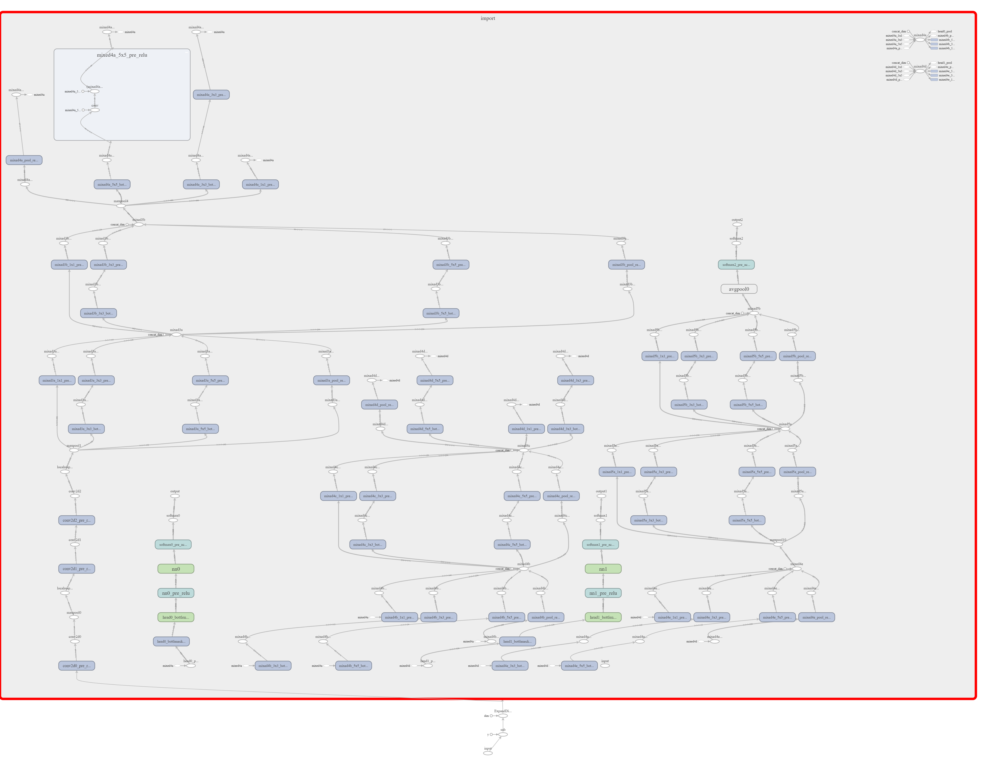

In [23]:

Image("graph.png")


Then we do gradient ascent on an image  in order to maximize the activation of a layer of the convnet.



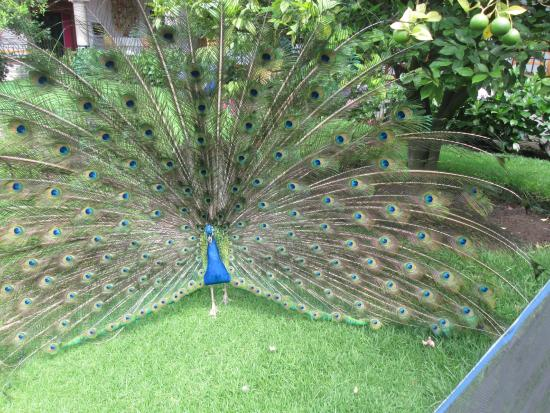

In [2]:

Image("pavo.jpg")

Inception 5h returns the following dreams:

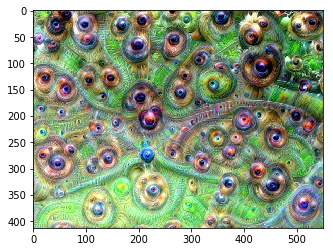

In [13]:
Image("maxpool4.png")

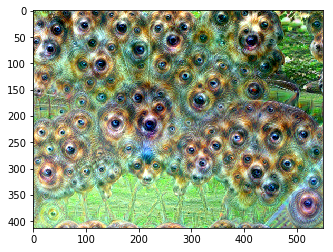

In [6]:
Image("mixed4a.png")

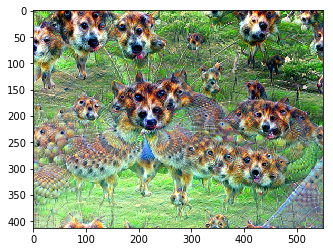

In [5]:
Image("mixed4b.png")

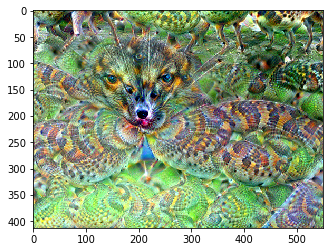

In [7]:
Image("mixed4c.png")

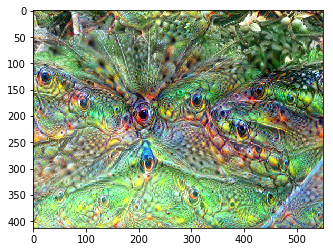

In [4]:
Image("mixed4d.png")

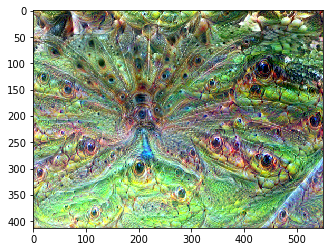

In [8]:
Image("mixed4e.png")


This modifies the original image with predefined shapes that the particular layer  was trained to recognize.


To do deep dreams we fix a layer, then we use gradient ascent on the image to obtain an image that maximizes a weighted sum of the L2 norm of the activations of the layer. 

We will move/modify the image to an image that activates the layer weights with a stronger value than the original image.

You can think of this as a process where the algorithm recognizes the remainings of a pattern and moves the picture to make that pattern stronger.

<br>
<br>
<br>
<font size='6' style="color:#00A6D6">  <b>How does it modifies the image?</b></font>

We usually have an input $x$ and want to find $a, b$ so that $ax+b$ is good. 
Suppose you found those $a, b$, now find $y$ so that $ay+b$ is good. In other words, change $y$ to $y+y_{1}$ to improve the function, we change role of the constants and the variables.


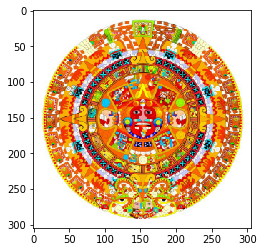

In [108]:
Image('solecito.png')

Then the program will add to it the following correction (we are visualizing the differentials!):

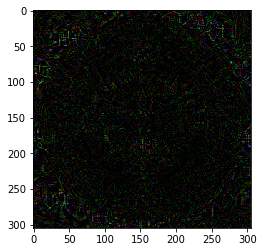

In [109]:
Image('diff.png')

and we sum this two images. In order words, the program recognizes some patters, and we add those patters and put them in the place.    

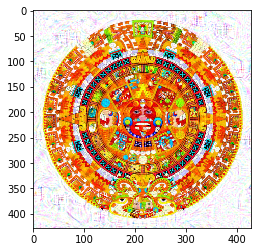

In [110]:
Image('solecito+diff.png')

##### parameter: number of iterations
This process is repetead several times, the more iterations, the more stuff added to the original picture.

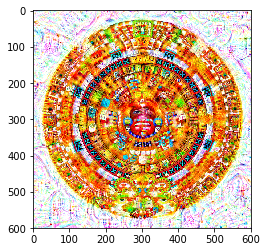

In [198]:
Image('more-stuff.png')

Besides the number of iterations, we also need to consider the number of Octaves.

In [100]:
#Please ignore this code
x = np.arange(16)
x = x.reshape(4,-1)
q_1=2.5*np.ones(4).reshape(2,-1)
q_2=4.5*np.ones(4).reshape(2,-1)
q_3=10.5*np.ones(4).reshape(2,-1)
q_4=12.5*np.ones(4).reshape(2,-1)
up = np.concatenate((q_1,q_3), axis=0)
down = np.concatenate((q_2,q_4), axis=0)
zoom = np.concatenate((up,down),axis =1)
details = x-means



Here $x$ represents an image with 16 pixeles,  we will make zoom to $x$.

In [81]:
x

array([[ 0,  1,  2,  3],
       [ 4,  5,  6,  7],
       [ 8,  9, 10, 11],
       [12, 13, 14, 15]])

Here Zoom is the mean of the values of a cuadrant.

In [101]:
zoom

array([[ 2.5,  2.5,  4.5,  4.5],
       [ 2.5,  2.5,  4.5,  4.5],
       [10.5, 10.5, 12.5, 12.5],
       [10.5, 10.5, 12.5, 12.5]])

 The difference between the original image and the zoomed image is called details and it help us to recover the original image from the zoomed one.

In [102]:
details


array([[-2.5, -1.5, -2.5, -1.5],
       [ 1.5,  2.5,  1.5,  2.5],
       [-2.5, -1.5, -2.5, -1.5],
       [ 1.5,  2.5,  1.5,  2.5]])

In [103]:
zoom+details

array([[ 0.,  1.,  2.,  3.],
       [ 4.,  5.,  6.,  7.],
       [ 8.,  9., 10., 11.],
       [12., 13., 14., 15.]])

We can see the effect of making zooms/octaves on an image:

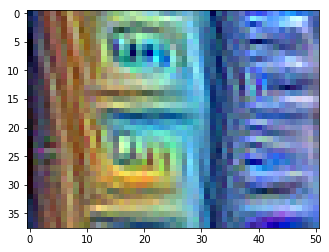

In [99]:
Image('16layers/8.png')

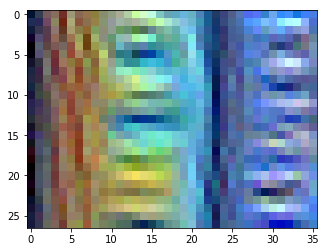

In [95]:
Image('16layers/7.png')

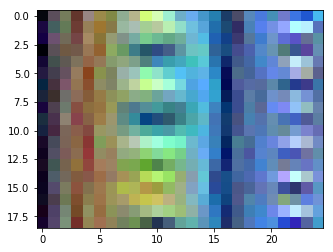

In [94]:
Image('16layers/6.png')

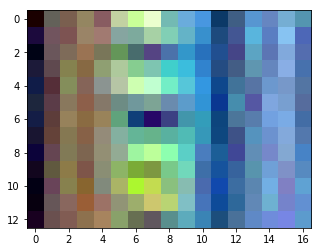

In [92]:
Image('16layers/5.png')

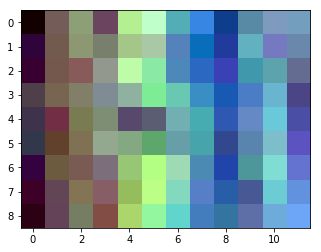

In [93]:
Image('16layers/4.png')

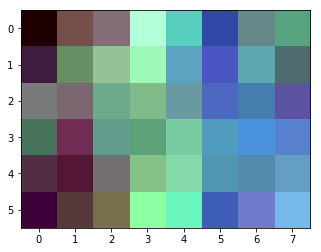

In [96]:
Image('16layers/3.png')

Now given an octave, we can upscale it and add details to recover a the previous octave, in fact we can continue all the way until we recover the original image.

But instead of that, we are going to add the dreams to the octaves, then upscale it, add details and dream it again... 

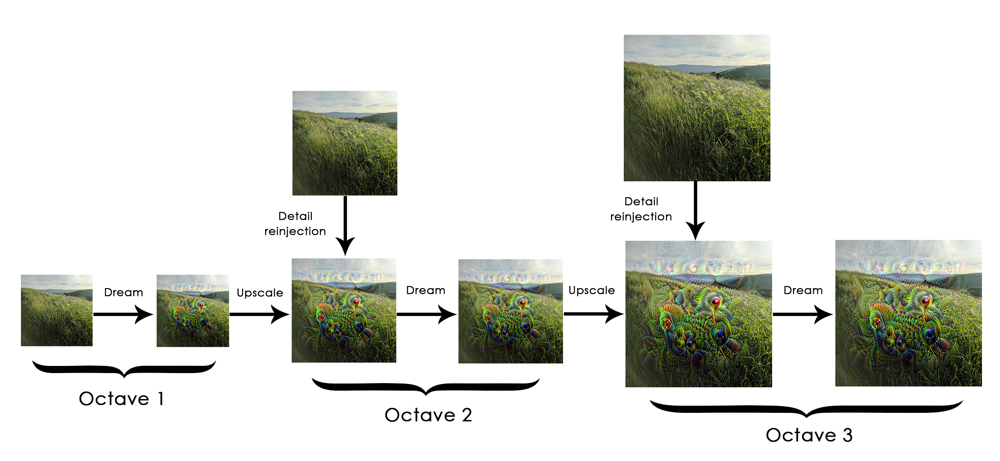

In [104]:
Image('upscale.png')

##### parameter: octaves
Increasing the number of octaves has a fractal effect, where the dream is going to look into smaller details:

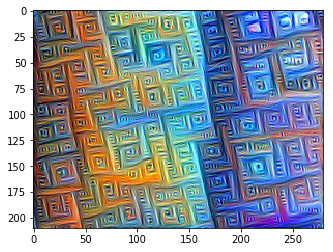

In [179]:
Image('16layers/14.png')

Compared with:

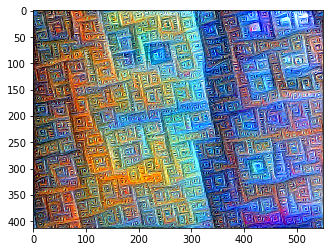

In [180]:
Image('16layers/16.png')

If you go into the code, you can actually print intermidle steps instead of waiting till the last octave, and that may be convenient for visual purpuses.

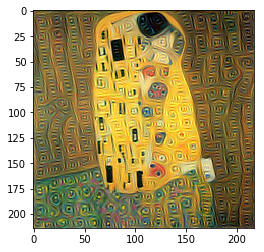

In [189]:
Image('10.png')

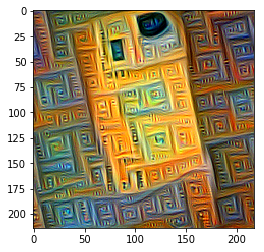

In [190]:
Image('16x7.png')

<br>
<br>
<br>
<font size='6' style="color:#00A6D6">  <b>How does the dream depend on the layer?</b></font>

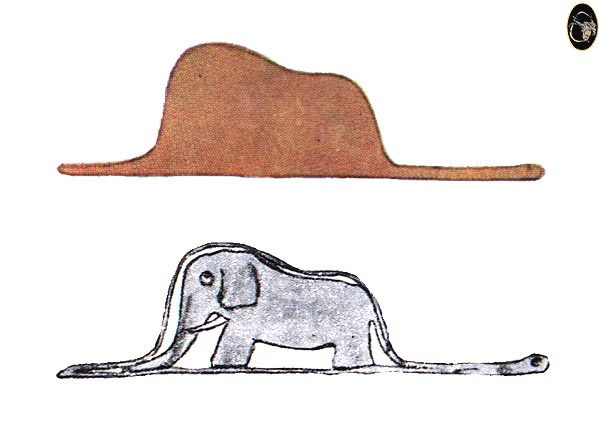

In [54]:
Image("elephant.jpg")

 Below we see the effect of early layers:

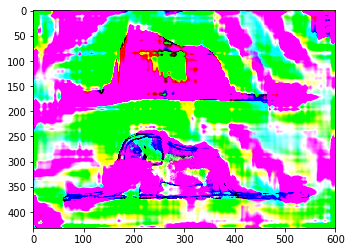

In [47]:
Image("Helefant/1.png")

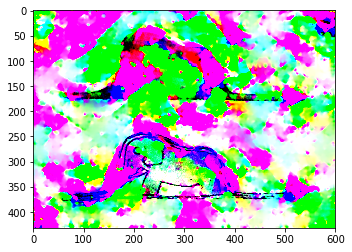

In [49]:
Image("Helefant/2.png")

We can contrast this images with the following images of latest layers:

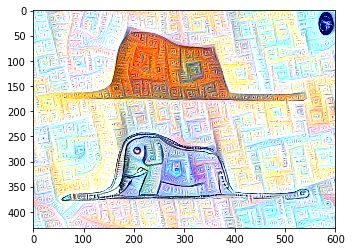

In [55]:
Image("Helefant/6.png")

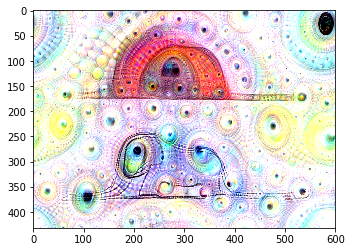

In [57]:
Image("Helefant/10.png")

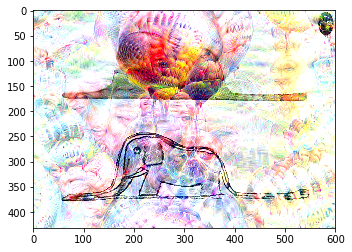

In [58]:
Image("Helefant/15.png")

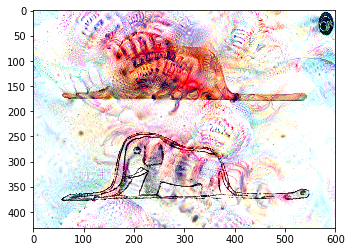

In [59]:
Image("Helefant/16.png")

<br>
<br>
<br>
<font size='6' style="color:#00A6D6">  <b>Can we see what each layer is learning?</b></font>

Here are the layers of Inception5h that we can work with:

In [ ]:
conv2d0
Maxpool0
conv2d1
conv2d2
Maxpool1
mixed3a
mixed3b
Maxpool4
mixed4a->NN->softmax->first output
mixed4b
mixed4c
mixed4d->NN->softmax->second output
mixed4e
Maxpool10
mixed5a
mixed5b
avgpool0
------------
softmax
third output

 The complete list is at https://github.com/jnordberg/dreamcanvas/issues/3 but for some images they return error, I suspect that depends on the size of the input image.

##### parameter: layers
For the initial layers the concepts are geometrical. For middle layers there seems to be images of eyes, dogs and snakes. This is because the Inception5h was trained with ImageNet, and so higher layers recognize classes of ImageNet.

One of my favourites is 'mixed3a':

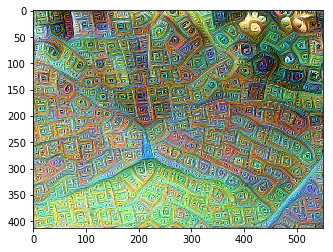

In [32]:
Image('mixed3a4octaves.png')

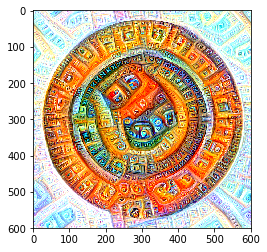

In [116]:
Image('calendar/6.png')

Very geometrical! We can see the dream that each layer returns:

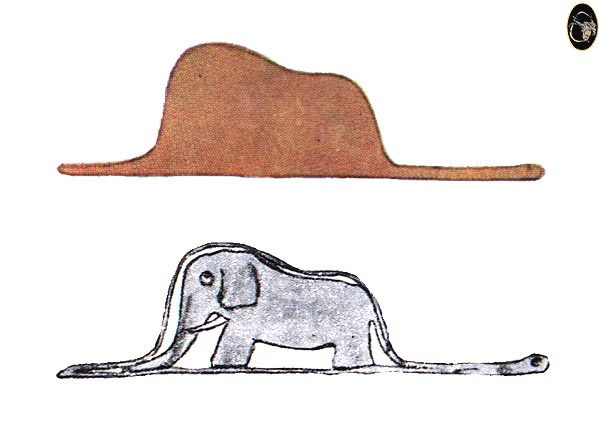

In [185]:
Image('elephant.jpg')

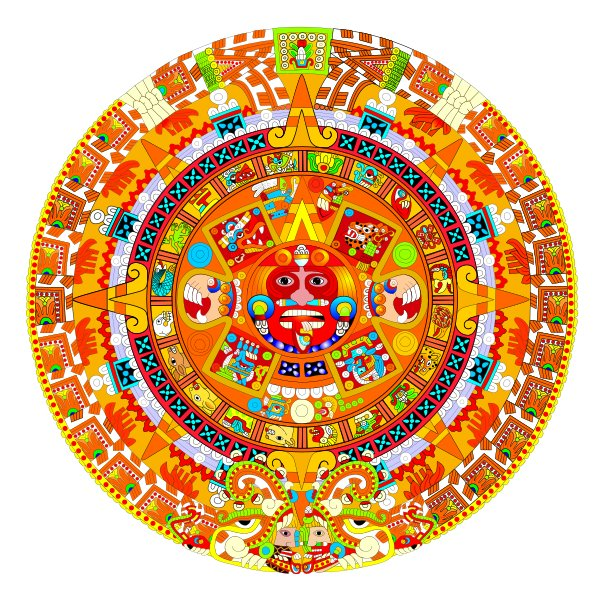

In [184]:
Image('aztec.jpg')

##### parameter: image
Notice that the images selected have a lot of white space. You can constranst with images with more detail as the ones at the beginning of the post. Homogeneous regions can be filled with patters if enough repetitions are chosen.

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Conv2d0</b></font>

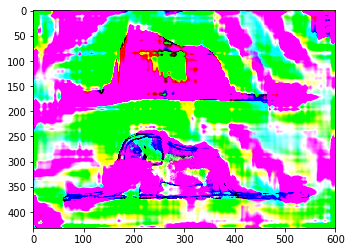

In [135]:
Image('Helefant/1.png')

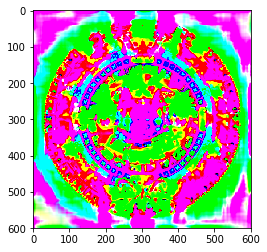

In [136]:
Image('calendar/1.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Maxpool0</b></font>

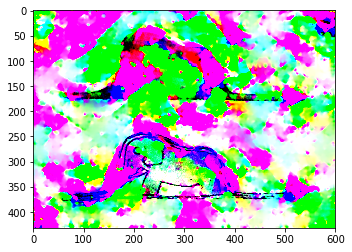

In [137]:
Image('Helefant/2.png')

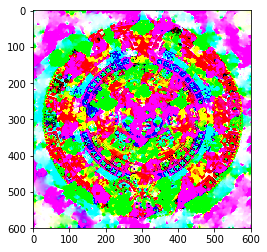

In [138]:
Image('calendar/2.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Conv2d1</b></font>

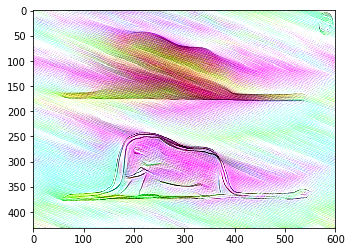

In [139]:
Image('Helefant/3.png')

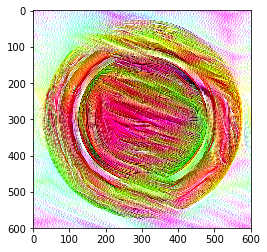

In [140]:
Image('calendar/3.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Conv2d2</b></font>

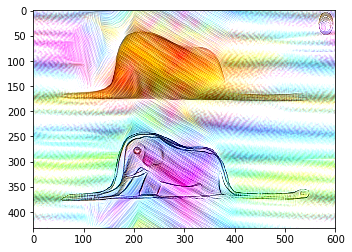

In [141]:
Image('Helefant/4.png')

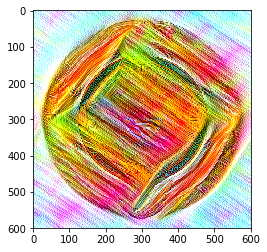

In [142]:
Image('calendar/4.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Maxpool1</b></font>

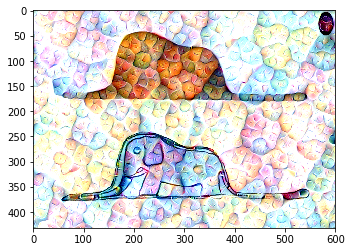

In [143]:
Image('Helefant/5.png')

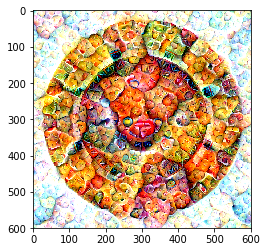

In [144]:
Image('calendar/5.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed3a</b></font>

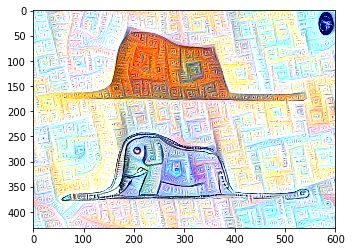

In [145]:
Image('Helefant/6.png')

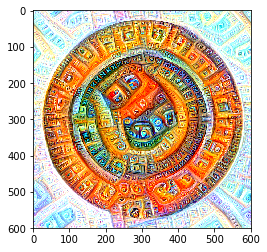

In [146]:
Image('calendar/6.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed3b</b></font>

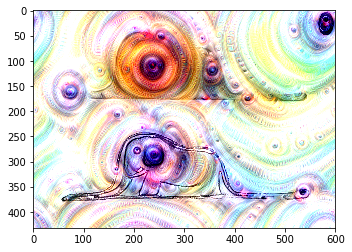

In [147]:
Image('Helefant/7.png')

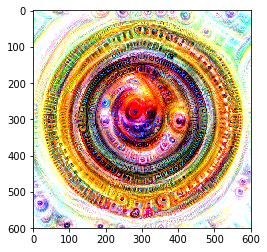

In [148]:
Image('calendar/7.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Maxpool4</b></font>

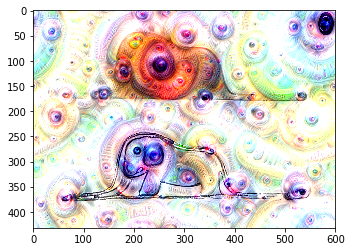

In [149]:
Image('Helefant/8.png')

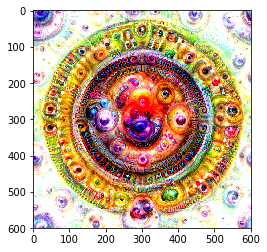

In [150]:
Image('calendar/8.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed4a</b></font>

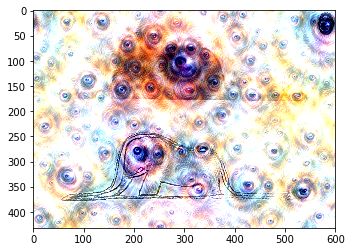

In [151]:
Image('Helefant/9.png')

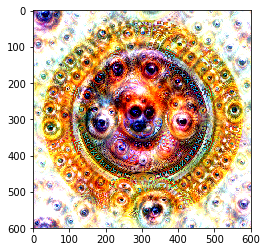

In [152]:
Image('calendar/9.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed4b</b></font> 

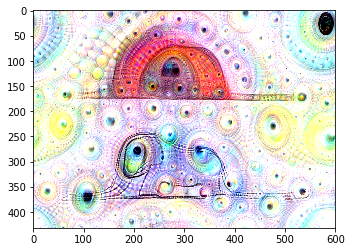

In [153]:
Image('Helefant/10.png')

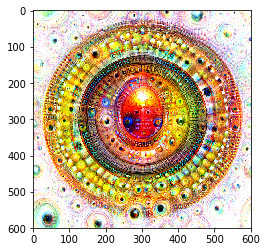

In [154]:
Image('calendar/10.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed4c</b></font> 

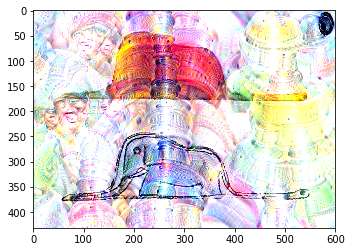

In [155]:
Image('Helefant/11.png')

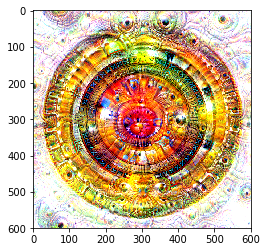

In [156]:
Image('calendar/11.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed4d</b></font> 

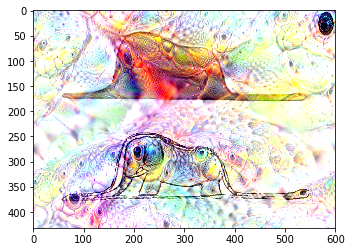

In [157]:
Image('Helefant/12.png')

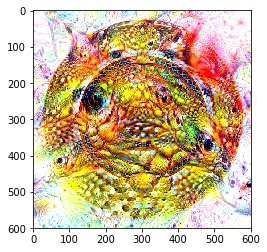

In [158]:
Image('calendar/12.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed4e</b></font> 

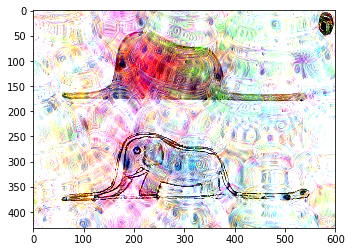

In [159]:
Image('Helefant/13.png')

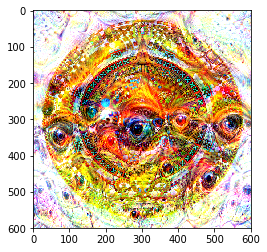

In [160]:
Image('calendar/13.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Maxpool10</b></font> 

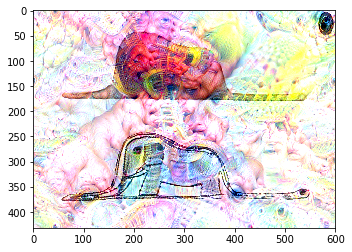

In [161]:
Image('Helefant/14.png')

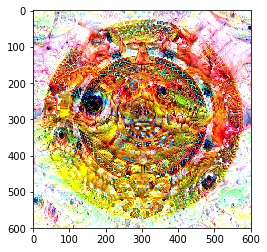

In [162]:
Image('calendar/14.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed5a</b></font> 

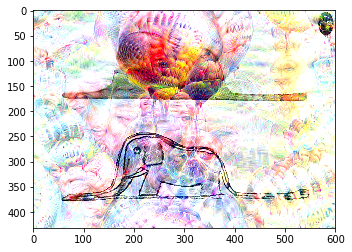

In [163]:
Image('Helefant/15.png')

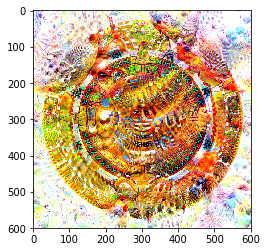

In [164]:
Image('calendar/15.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Mixed5b</b></font> 


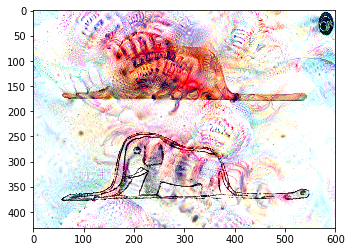

In [165]:
Image('Helefant/16.png')

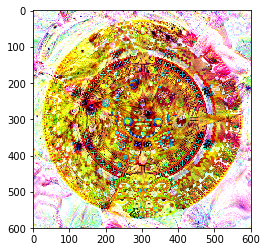

In [166]:
Image('calendar/16.png')

<br>
<br>
<br>
<font size='5' style="color:#4CAF50">  <b>Avgpool0</b></font> 

This seems to require only big images, so it didn't work with the previous ones:

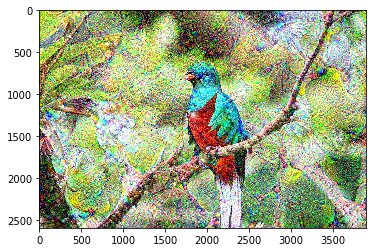

In [167]:
Image('avgpool0.png')

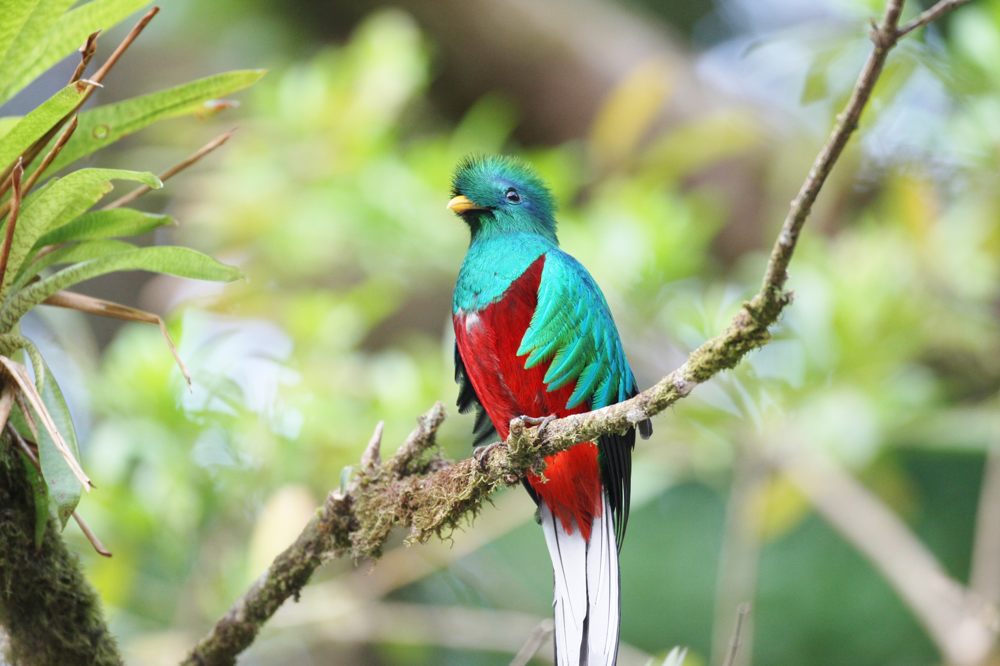

In [169]:
Image('quetzal.jpg')

But dreams have movement!

In [4]:
### I didnt include the next 2 videos as they weight 2 megas

In [6]:
#from IPython.display import HTML

# Youtube
#HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/cAe1lVDbLf0?rel=0" frameborder="0" allow="autoplay; encrypted-media" allowfullscreen></iframe>')




In [8]:
#So I made videos of them using mixed3a with 5 iterations, 7 octaves:

In [9]:
#from IPython.display import HTML

#HTML("""<video width="320" height="240" controls><source src="out.mp4" type="video/mp4"></video>""")

In [10]:
#and here is mixed3a with 50 iterations, 6 octaves:

In [11]:
#from IPython.display import HTML

#HTML("""<video width="320" height="240" controls><source src="bout.mp4" type="video/mp4"></video>""")

One problem with those visualizations is that at each frame, the algorithm calculates dreams without looking at the previous frames. 


We found a code that kind of solves this problem. 

3 iterations, 3 octaves.

In [3]:
from IPython.display import HTML
HTML("""
<video width="320" height="240" controls>
  <source src="outst.mp4" type="video/mp4">
</video>
""")

In [2]:
from IPython.display import HTML

# Youtube
HTML('<iframe width="560" height="315" src="https://www.youtube.com/embed/CSaFgAwnRSc?rel=0&amp;start=60" frameborder="0" allow="autoplay; encrypted-media" allowfullscreen></iframe>')




5 iterations, 7 octaves, mixed5b:

In [4]:

HTML("""
<video width="320" height="240" controls>
  <source src="outp.mp4" type="video/mp4">
</video>
""")

5 iterations, 7 octaves, mixed4d:


In [5]:

HTML("""
<video width="320" height="240" controls>
  <source src="snake.mp4" type="video/mp4">
</video>
""")

While this have few iterations, the number of octaves is 7, so I suspect that with a smaller number of octaves we will be able to see a dream closer to the original video.

My code uses 4 parameters, in the notebook I explained how tuning each one affects the dream:

Number of iterations. 
The process is repetead several times, the more iterations, the more stuff added to the original picture.

Octaves.
Increasing the number of octaves has a fractal effect, where the dream is going to look into smaller details.

Layers/convnet.
For the initial layers the concepts are geometrical. For middle layers there seems to be images of eyes, dogs and snakes. This is because the Inception5h was trained with ImageNet, and so higher layers recognize classes of ImageNet. You can change the convenet to one trained on buildings, or other things to get different patterns.

Image.
Homogeneous regions can be filled with patters if enough repetitions are chosen. Regions with a lot of details require more octaves and will show smaller patterns.

The following line:
            
            t_grad = tf.gradients(t_score, t_input)[0] 
            
Calculates the formal gradients of 't_score' with respect to 't_input'

C:\Users\FSU\Anaconda2\envs\ML\lib\site-packages\tensorflow\python\client\session.py:1711: UserWarning: An interactive session is already active. This can cause out-of-memory errors in some cases. You must explicitly call `InteractiveSession.close()` to release resources held by the other session(s).
  warnings.warn('An interactive session is already active. This can '


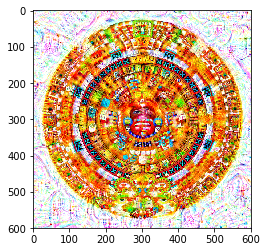

In [196]:
#Most of the code is from https://www.youtube.com/watch?v=MrBzgvUNr4w
##It may help you to watch that video
import numpy as np
from functools import partial
import PIL.Image
import tensorflow as tf
import matplotlib.pyplot as plt
import urllib.request
import os
import zipfile
from datetime import datetime


def main(img0, lay,iter_n, octave_n ):
    now = datetime.utcnow().strftime("%Y%m%d%H%M%S")
    root_logdir = "tf_logs"
    logdir = "{}/run-{}/".format(root_logdir, now)
    
    #Step 1 - download google's pre-trained neural network
    url = 'https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip'
    data_dir = '../data/'
    model_name = os.path.split(url)[-1]
    local_zip_file = os.path.join(data_dir, model_name)
    if not os.path.exists(local_zip_file):
        # Download
        model_url = urllib.request.urlopen(url)
        with open(local_zip_file, 'wb') as output:
            output.write(model_url.read())
        # Extract
        with zipfile.ZipFile(local_zip_file, 'r') as zip_ref:
            zip_ref.extractall(data_dir)
  
    # start with a gray image with a little noise
    img_noise = np.random.uniform(size=(224,224,3)) + 100.0
  
    model_fn = 'tensorflow_inception_graph.pb'
    
    #Step 2 - Creating Tensorflow session and loading the model
    graph = tf.Graph()
    sess = tf.InteractiveSession(graph=graph, config=tf.ConfigProto(log_device_placement=True))
    with tf.gfile.FastGFile(os.path.join(data_dir, model_fn), 'rb') as f:
        graph_def = tf.GraphDef()
        graph_def.ParseFromString(f.read())
    t_input = tf.placeholder(np.float32, name='input') # define the input tensor
    imagenet_mean = 117.0
    t_preprocessed = tf.expand_dims(t_input-imagenet_mean, 0)
    tf.import_graph_def(graph_def, {'input':t_preprocessed})
    #list of layers
    #layers = [op.name for op in graph.get_operations() if op.type=='Conv2D' and 'import/' in op.name]
    #feature_nums = [int(graph.get_tensor_by_name(name+':0').get_shape()[-1]) for name in layers]
    
    #print('Number of layers', len(layers))
    #print('Total number of feature channels:', sum(feature_nums))
    
    file_writer = tf.summary.FileWriter(logdir, tf.get_default_graph())
    x = graph.get_operations()
 #####HELPER FUNCTIONS. Watch https://www.youtube.com/watch?v=MrBzgvUNr4w They are mostly just formatting functions. Scroll 
 #to the bottom #########################################################################################################
 ########################################################################################################################
 ############################################################
 
    # Helper functions for TF Graph visualization
    #pylint: disable=unused-variable
    def strip_consts(graph_def, max_const_size=32):
        """Strip large constant values from graph_def."""
        strip_def = tf.GraphDef()
        for n0 in graph_def.node:
            n = strip_def.node.add() #pylint: disable=maybe-no-member
            n.MergeFrom(n0)
            if n.op == 'Const':
                tensor = n.attr['value'].tensor
                size = len(tensor.tensor_content)
                if size > max_const_size:
                    tensor.tensor_content = "<stripped %d bytes>"%size
        return strip_def
      
    def rename_nodes(graph_def, rename_func):
        res_def = tf.GraphDef()
        for n0 in graph_def.node:
            n = res_def.node.add() #pylint: disable=maybe-no-member
            n.MergeFrom(n0)
            n.name = rename_func(n.name)
            for i, s in enumerate(n.input):
                n.input[i] = rename_func(s) if s[0]!='^' else '^'+rename_func(s[1:])
        return res_def
      
    def showarray(a):
        a = np.uint8(np.clip(a, 0, 1)*255)
        plt.imshow(a)
        plt.show()
        
    def visstd(a, s=0.1):
        '''Normalize the image range for visualization'''
        return (a-a.mean())/max(a.std(), 1e-4)*s + 0.5
    
    def T(layer):
        '''Helper for getting layer output tensor'''
        return graph.get_tensor_by_name("import/%s:0"%layer)
    
    def render_naive(t_obj, img0=img_noise, iter_n=20, step=1.0):
        t_score = tf.reduce_mean(t_obj) # defining the optimization objective
        t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
        
        img = img0.copy()
        for _ in range(iter_n):
            g, _ = sess.run([t_grad, t_score], {t_input:img})
            # normalizing the gradient, so the same step size should work 
            g /= g.std()+1e-8         # for different layers and networks
            img += g*step
        showarray(visstd(img))
        
    def tffunc(*argtypes):
        '''Helper that transforms TF-graph generating function into a regular one.
        See "resize" function below.
        '''
        placeholders = list(map(tf.placeholder, argtypes))
        def wrap(f):
            out = f(*placeholders)
            def wrapper(*args, **kw):
                return out.eval(dict(zip(placeholders, args)), session=kw.get('session'))
            return wrapper
        return wrap
    
    def resize(img, size):
        img = tf.expand_dims(img, 0)
        return tf.image.resize_bilinear(img, size)[0,:,:,:]
    resize = tffunc(np.float32, np.int32)(resize)
    
    def calc_grad_tiled(img, t_grad, tile_size=512):
        '''Compute the value of tensor t_grad over the image in a tiled way.
        Random shifts are applied to the image to blur tile boundaries over 
        multiple iterations.'''
        sz = tile_size
        h, w = img.shape[:2]
        sx, sy = np.random.randint(sz, size=2)
        img_shift = np.roll(np.roll(img, sx, 1), sy, 0)
        grad = np.zeros_like(img)
        for y in range(0, max(h-sz//2, sz),sz):
            for x in range(0, max(w-sz//2, sz),sz):
                sub = img_shift[y:y+sz,x:x+sz]
                g = sess.run(t_grad, {t_input:sub})
                grad[y:y+sz,x:x+sz] = g
        return np.roll(np.roll(grad, -sx, 1), -sy, 0)    

    
        
        
    def render_deepdream(t_obj, img0=img_noise,
                         iter_n=60, step=1.5, octave_n=5, octave_scale=1.4):
        t_score = tf.reduce_mean(t_obj) # defining the optimization objective
        t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
    
        # split the image into a number of octaves
        img = img0
        octaves = []
        for _ in range(octave_n-1):
            hw = img.shape[:2]
            lo = resize(img, np.int32(np.float32(hw)/octave_scale))
            hi = img-resize(lo, hw)
            img = lo
            octaves.append(hi)
            
            
        # generate details octave by octave
        for octave in range(octave_n):
            if octave>0:
                hi = octaves[-octave]
                img = resize(img, hi.shape[:2])+hi
            #diff = np.zeros_like(img) #to see the differentials 
            for _ in range(iter_n):
                g = calc_grad_tiled(img, t_grad)
                #diff = diff +g*(step / (np.abs(g).mean()+1e-7))
                img += g*(step / (np.abs(g).mean()+1e-7))
            
            #this will usually be like 3 or 4 octaves
            #Step 5 output deep dream image via matplotlib
            #showarray(diff/255.0) #This shows the gradients
        showarray(img/255.0)#Renormalization!
        
        return img/255.0    
         
  
   	#Step 3 - layer is in variable lay
    
    #open image
    img0 = np.float32(img0)
    #Step 4 - Apply gradient ascent to that layer
    #mlayers  = 'conv2d0 maxpool0 conv2d1 conv2d2 maxpool1 mixed3a mixed3b maxpool4 mixed4a mixed4b mixed4c mixed4d mixed4e maxpool10 mixed5a mixed5b avgpool0'
    #this  = mlayers.split(' ')#to work with all layers one after the other
    #for word in this:
    #    render_deepdream(tf.square(T(word)), img0, iter_n= itern_n, octave_n=octave_n)
    render_deepdream(tf.square(T(lay)), img0, iter_n= iter_n, octave_n=octave_n)
    file_writer.close()  
    sess.close()
if __name__ == '__main__':
    main(PIL.Image.open('aztec.jpg'), 'avgpool0',80, 4 )
    #parameters: image, layer, n_iterations,n_octaves

In [13]:
import gc
gc.collect()

0

In [ ]:
#this one makes videos!
'''''''''
 First, you take your source video, and you render it out into a series of images. 
 This is super easy to do with ffmpeg. In fact, it's a one liner:

$ ffmpeg -i input.mp4 %05d.jpg

 Save them in folder+'movie/min/'
 And then run every image through the deep dream.

 Finally, to convert our image sequence back into a video, we do the ffmpeg command in reverse:

$ ffmpeg -i %05d.jpg out.mp4
'''''''''
#
import numpy as np
from functools import partial
import PIL.Image
import tensorflow as tf
import matplotlib.pyplot as plt
import urllib.request
import os
import zipfile
#import glob    # used to get list of all jpegs in directory
import timeit  # used to time how long it's gonna take
import cv2
start_time = timeit.default_timer() # start the timer before we start


def main():
    #Step 1 - download google's pre-trained neural network
    url = 'https://storage.googleapis.com/download.tensorflow.org/models/inception5h.zip'
    data_dir = '/data/'
    model_name = os.path.split(url)[-1]
    local_zip_file = os.path.join(data_dir, model_name)
    if not os.path.exists(local_zip_file):
        # Download
        model_url = urllib.request.urlopen(url)
        with open(local_zip_file, 'wb') as output:
            output.write(model_url.read())
        # Extract
        with zipfile.ZipFile(local_zip_file, 'r') as zip_ref:
            zip_ref.extractall(data_dir)
  
    # start with a gray image with a little noise
    img_noise = np.random.uniform(size=(224,224,3)) + 100.0
  
    model_fn = 'tensorflow_inception_graph.pb'
    
    #Step 2 - Creating Tensorflow session and loading the model
    graph = tf.Graph()
    sess = tf.InteractiveSession(graph=graph)
    with tf.gfile.FastGFile(os.path.join(data_dir, model_fn), 'rb') as f:
        graph_def = tf.GraphDef()
        graph_def.ParseFromString(f.read())
    t_input = tf.placeholder(np.float32, name='input') # define the input tensor
    imagenet_mean = 117.0
    t_preprocessed = tf.expand_dims(t_input-imagenet_mean, 0)
    tf.import_graph_def(graph_def, {'input':t_preprocessed})
    
    layers = [op.name for op in graph.get_operations() if op.type=='Conv2D' and 'import/' in op.name]
    feature_nums = [int(graph.get_tensor_by_name(name+':0').get_shape()[-1]) for name in layers]
    
    print('Number of layers', len(layers))
    print('Total number of feature channels:', sum(feature_nums))
  
 #####HELPER FUNCTIONS. They are mostly just formatting functions. Scroll 
 #to the bottom #########################################################################################################
 ########################################################################################################################
 ############################################################
 
    # Helper functions for TF Graph visualization
    #pylint: disable=unused-variable
    def strip_consts(graph_def, max_const_size=32):
        """Strip large constant values from graph_def."""
        strip_def = tf.GraphDef()
        for n0 in graph_def.node:
            n = strip_def.node.add() #pylint: disable=maybe-no-member
            n.MergeFrom(n0)
            if n.op == 'Const':
                tensor = n.attr['value'].tensor
                size = len(tensor.tensor_content)
                if size > max_const_size:
                    tensor.tensor_content = "<stripped %d bytes>"%size
        return strip_def
      
    def rename_nodes(graph_def, rename_func):
        res_def = tf.GraphDef()
        for n0 in graph_def.node:
            n = res_def.node.add() #pylint: disable=maybe-no-member
            n.MergeFrom(n0)
            n.name = rename_func(n.name)
            for i, s in enumerate(n.input):
                n.input[i] = rename_func(s) if s[0]!='^' else '^'+rename_func(s[1:])
        return res_def
      
    def showarray(a):
        a = np.uint8(np.clip(a, 0, 1)*255)
        plt.imshow(a)
        plt.show()
        
    def visstd(a, s=0.1):
        '''Normalize the image range for visualization'''
        return (a-a.mean())/max(a.std(), 1e-4)*s + 0.5
    
    def T(layer):
        '''Helper for getting layer output tensor'''
        return graph.get_tensor_by_name("import/%s:0"%layer)
    
    def render_naive(t_obj, img0=img_noise, iter_n=20, step=1.0):
        t_score = tf.reduce_mean(t_obj) # defining the optimization objective
        t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
        
        img = img0.copy()
        for _ in range(iter_n):
            g, _ = sess.run([t_grad, t_score], {t_input:img})
            # normalizing the gradient, so the same step size should work 
            g /= g.std()+1e-8         # for different layers and networks
            img += g*step
        showarray(visstd(img))
        
    def tffunc(*argtypes):
        '''Helper that transforms TF-graph generating function into a regular one.
        See "resize" function below.
        '''
        placeholders = list(map(tf.placeholder, argtypes))
        def wrap(f):
            out = f(*placeholders)
            def wrapper(*args, **kw):
                return out.eval(dict(zip(placeholders, args)), session=kw.get('session'))
            return wrapper
        return wrap
    
    def resize(img, size):
        img = tf.expand_dims(img, 0)
        return tf.image.resize_bilinear(img, size)[0,:,:,:]
    resize = tffunc(np.float32, np.int32)(resize)
    
    def calc_grad_tiled(img, t_grad, tile_size=512):
        '''Compute the value of tensor t_grad over the image in a tiled way.
        Random shifts are applied to the image to blur tile boundaries over 
        multiple iterations.'''
        sz = tile_size
        h, w = img.shape[:2]
        sx, sy = np.random.randint(sz, size=2)
        img_shift = np.roll(np.roll(img, sx, 1), sy, 0)
        grad = np.zeros_like(img)
        for y in range(0, max(h-sz//2, sz),sz):
            for x in range(0, max(w-sz//2, sz),sz):
                sub = img_shift[y:y+sz,x:x+sz]
                g = sess.run(t_grad, {t_input:sub})##t_grad = symbolic derivatives of sum of t_score w.r.t. t_input 
                grad[y:y+sz,x:x+sz] = g
        return np.roll(np.roll(grad, -sx, 1), -sy, 0)    

    #VIDEO###########################################################################################
    ########################################################################################################
    ##############################################################################
    
        
        
    def render_deepdream(t_obj, img0=img_noise,
                         iter_n=5, step=1.5, octave_n=7, octave_scale=1.4):
        t_score = tf.reduce_mean(t_obj) # defining the optimization objective
        t_grad = tf.gradients(t_score, t_input)[0] # behold the power of automatic differentiation!
        #Constructs symbolic derivatives of sum of t_score w.r.t. t_input 
        # split the image into a number of octaves
        img = img0
        octaves = []
        for _ in range(octave_n-1):
            hw = img.shape[:2]
            lo = resize(img, np.int32(np.float32(hw)/octave_scale))
            hi = img-resize(lo, hw)
            img = lo
            octaves.append(hi)
        
        # generate details octave by octave
        for octave in range(octave_n):
            if octave>0:
                hi = octaves[-octave]
                img = resize(img, hi.shape[:2])+hi
            for _ in range(iter_n):
                g = calc_grad_tiled(img, t_grad)
                img += g*(step / (np.abs(g).mean()+1e-7))
            
            #this will usually be like 3 or 4 octaves
            #Step 5 output deep dream image via matplotlib
        return(img)
            
         
############################## You need to change this to your local configuration  
############################## the frames of the video are in folder+'movie/min/'
############################## the deep dreamed frames are in foler+'output/'
    folder = '/im-data/'
    
#######################The following code comes from reddit and it is intended to make dreams 
################take into account the previous image
##########

    lay='mixed4d'
    img = np.float32(PIL.Image.open(folder+'movie/min/01801.jpg')) 
    # assumes you've run `ffmpeg -i input.mp4 output%05d.jpg`, and all images are in same directory as script

    h, w, c = img.shape  # get our video source's image size
    hallu = render_deepdream(tf.square(T(lay)), img) # do the first deep dream


    np.clip(hallu, 0, 255, out=hallu) # clip our RGB values to 255, don't go over!
    PIL.Image.fromarray(np.uint8(hallu)).save(folder+'output/00000.jpg') # save the first one
    grayImg = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)  # create a greyscale of our image
    num_files = 1 # start a counter
    ####Here I didn't want to dream the whole video so I choose an interval
    for ind in range(1802,2677):
        filename = folder+'movie/min/0'+str(ind)+'.jpg'
        previousImg = img  # use the previous img as a reference to calculate optical flow
        previousGrayImg = grayImg  # and the same for greyscale
        img = np.float32(PIL.Image.open(filename)) # load current image
        grayImg = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)  # create new greyscale
        flow = cv2.calcOpticalFlowFarneback(previousGrayImg, grayImg, None, pyr_scale=0.5, levels=3, winsize=15, iterations=3, poly_n=5, poly_sigma=1.2, flags=0)
        # calculate opticalflow from opencv. feel free to go wild with options, playing until you find what fits.

        flow = -flow
        flow[:,:,0] += np.arange(w)
        flow[:,:,1] += np.arange(h)[:,np.newaxis]
        halludiff = hallu - previousImg
        halludiff = cv2.remap(halludiff, flow, None, cv2.INTER_LINEAR)  # fit hallucination to the flow difference 
        hallu = img + halludiff # add it back to the image
        hallu = render_deepdream(tf.square(T(lay)), hallu)
        np.clip(hallu, 0, 255, out=hallu)
        PIL.Image.fromarray(np.uint8(hallu)).save(folder+'output/'+'{num:05d}'.format(num=num_files)+'.jpg')
        print( "Finished file number " + str(num_files) )
        num_files += 1

    elapsed = timeit.default_timer() - start_time
    print( "Ran through " + str(num_files) + " in " + str(elapsed) + "seconds. ")

if __name__ == '__main__':
    main()

Here we calculate how to modify the image.

In [ ]:
def calc_grad_tiled(img, t_grad, tile_size=512):
    '''Compute the value of tensor t_grad over the image in a tiled way.
    Random shifts are applied to the image to blur tile boundaries over 
    multiple iterations.'''
    sz = tile_size
    h, w = img.shape[:2]
    sx, sy = np.random.randint(sz, size=2)
    img_shift = np.roll(np.roll(img, sx, 1), sy, 0)
    grad = np.zeros_like(img)
    for y in range(0, max(h-sz//2, sz),sz):
        for x in range(0, max(w-sz//2, sz),sz):
            sub = img_shift[y:y+sz,x:x+sz]
            g = sess.run(t_grad, {t_input:sub})#t_grad is the symbolic derivatives of sum of squares of activation functions w.r.t. t_input  
            grad[y:y+sz,x:x+sz] = g
    return np.roll(np.roll(grad, -sx, 1), -sy, 0)    
for octave in range(octave_n):
    if octave>0:
        hi = octaves[-octave]
        img = resize(img, hi.shape[:2])+hi

    for _ in range(iter_n):
        g = calc_grad_tiled(img, t_grad)
        img += g*(step / (np.abs(g).mean()+1e-7))

    #this will usually be like 3 or 4 octaves
    #Step 5 output deep dream image via matplotlib
    showarray(img/255.0)

<br>    
<br>    
<br>    
<font size='6' style="color:#00A6D6">  <b>Summary</b></font>

<br>    
<br>    
<br>    
<font size='6' style="color:#00A6D6">  <b>References</b></font>


* The original source requires Caffe https://github.com/google/deepdream/blob/master/dream.ipynb

* This tensorflow tutorial allows you to choose your convenet and select the layers that you want to focus on.
https://github.com/llSourcell/deep_dream_challenge/blob/master/deep_dream.py

* Here you can also add an image and then the algorithm will detect which layers are leaning that pattern, then you can do dreams with that pattern. Since this code requires coffe, I modified it to work with the previous link.  https://github.com/burningion/deepdreamtutorial/blob/master/divingdeeper.ipynb

* Here is a complete implementation using keras: https://github.com/fchollet/deep-learning-with-python-notebooks/blob/master/8.2-deep-dream.ipynb

* The code is an modification of  https://www.youtube.com/watch?v=MrBzgvUNr4w
 https://github.com/llSourcell/deep_dream_challenge
* The layers from inception https://github.com/jnordberg/dreamcanvas/issues/3